In [0]:
#importing libraries
!pip install pyspark
!pip install findspark
!pip install plotly
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

from pyspark.context import SparkContext
from pyspark.sql.session import SparkSession
from pyspark.ml.feature import StringIndexer, VectorAssembler, OneHotEncoder
from pyspark.sql.functions import isnull, when, count, col, isnan, avg
from subprocess import check_output
from pyspark.sql import SparkSession
from functools import reduce
from pyspark.ml.stat import Correlation
from pyspark.sql.types import *



You should consider upgrading via the '/databricks/python3/bin/python -m pip install --upgrade pip' command.
You should consider upgrading via the '/databricks/python3/bin/python -m pip install --upgrade pip' command.
You should consider upgrading via the '/databricks/python3/bin/python -m pip install --upgrade pip' command.


In [0]:
#Loading the data into dataframe
df = spark.read.format("csv").option("header", "true").load("dbfs:/FileStore/shared_uploads/pavula@gmu.edu/Adult_final.csv")
#Displaying the data
display(df)

age,workclass,fnlwgt,education,marital.status,occupation,relationship,race,sex,capital.gain,capital.loss,hours.per.week,native.country,income
82,Private,132870,HS-grad,Widowed,Exec-managerial,Not-in-family,White,Female,0,4356,18,United-States,<=50K
54,Private,140359,7th-8th,Divorced,Machine-op-inspct,Unmarried,White,Female,0,3900,40,United-States,<=50K
41,Private,264663,Some-college,Separated,Prof-specialty,Own-child,White,Female,0,3900,40,United-States,<=50K
34,Private,216864,HS-grad,Divorced,Other-service,Unmarried,White,Female,0,3770,45,United-States,<=50K
38,Private,150601,10th,Separated,Adm-clerical,Unmarried,White,Male,0,3770,40,United-States,<=50K
74,State-gov,88638,Doctorate,Never-married,Prof-specialty,Other-relative,White,Female,0,3683,20,United-States,>50K
68,Federal-gov,422013,HS-grad,Divorced,Prof-specialty,Not-in-family,White,Female,0,3683,40,United-States,<=50K
45,Private,172274,Doctorate,Divorced,Prof-specialty,Unmarried,Black,Female,0,3004,35,United-States,>50K
38,Self-emp-not-inc,164526,Prof-school,Never-married,Prof-specialty,Not-in-family,White,Male,0,2824,45,United-States,>50K
52,Private,129177,Bachelors,Widowed,Other-service,Not-in-family,White,Female,0,2824,20,United-States,>50K


In [0]:
#display the summary
display(df.summary())

summary,age,workclass,fnlwgt,education,marital.status,occupation,relationship,race,sex,capital.gain,capital.loss,hours.per.week,native.country,income
count,30162,30162,30162,30162,30162,30162,30162,30162,30162,30162,30162,30162,30162,30162
mean,38.437901995888865,null,189793.83393011073,null,null,null,null,null,null,1092.0078575691268,88.37248856176646,40.93123798156621,null,null
stddev,13.134664776856031,null,105652.9715285195,null,null,null,null,null,null,7406.346496683517,404.2983704863763,11.97998422927492,null,null
min,17,Federal-gov,100009,10th,Divorced,Adm-clerical,Husband,Amer-Indian-Eskimo,Female,0,0,1,Cambodia,<=50K
25%,28.0,null,117618.0,null,null,null,null,null,null,0.0,0.0,40.0,null,null
50%,37.0,null,178417.0,null,null,null,null,null,null,0.0,0.0,40.0,null,null
75%,47.0,null,237608.0,null,null,null,null,null,null,0.0,0.0,45.0,null,null
max,90,Without-pay,99987,Some-college,Widowed,Transport-moving,Wife,White,Male,99999,974,99,Yugoslavia,>50K


In [0]:
#Changing the column names as the original data contains .
oldColumns = df.schema.names
newColumns = [
     "age",
     "workclass",
     "finalweight",
     "education",
     "maritalstatus",
     "occupation",
     "relationship",
     "race",
     "sex",
     "capitalgain",
     "capitalloss",
     "hoursperweek",
     "nativecountry",
     "income"
 ]

df = reduce(lambda df, idx: df.withColumnRenamed(oldColumns[idx], newColumns[idx]), range(len(oldColumns)), df)
df.printSchema()

root
 |-- age: string (nullable = true)
 |-- workclass: string (nullable = true)
 |-- finalweight: string (nullable = true)
 |-- education: string (nullable = true)
 |-- maritalstatus: string (nullable = true)
 |-- occupation: string (nullable = true)
 |-- relationship: string (nullable = true)
 |-- race: string (nullable = true)
 |-- sex: string (nullable = true)
 |-- capitalgain: string (nullable = true)
 |-- capitalloss: string (nullable = true)
 |-- hoursperweek: string (nullable = true)
 |-- nativecountry: string (nullable = true)
 |-- income: string (nullable = true)



In [0]:
# changing the datatypes
df = df.withColumn("hoursperweek", col("hoursperweek").cast("integer"))
df = df.withColumn("age", col("age").cast("integer"))
df = df.withColumn("finalweight", col("finalweight").cast("integer"))
df = df.withColumn("capitalgain", col("capitalgain").cast("integer"))
df = df.withColumn("capitalloss", col("capitalloss").cast("integer"))

In [0]:
df.display()

age,workclass,finalweight,education,maritalstatus,occupation,relationship,race,sex,capitalgain,capitalloss,hoursperweek,nativecountry,income
82,Private,132870,HS-grad,Widowed,Exec-managerial,Not-in-family,White,Female,0,4356,18,United-States,<=50K
54,Private,140359,7th-8th,Divorced,Machine-op-inspct,Unmarried,White,Female,0,3900,40,United-States,<=50K
41,Private,264663,Some-college,Separated,Prof-specialty,Own-child,White,Female,0,3900,40,United-States,<=50K
34,Private,216864,HS-grad,Divorced,Other-service,Unmarried,White,Female,0,3770,45,United-States,<=50K
38,Private,150601,10th,Separated,Adm-clerical,Unmarried,White,Male,0,3770,40,United-States,<=50K
74,State-gov,88638,Doctorate,Never-married,Prof-specialty,Other-relative,White,Female,0,3683,20,United-States,>50K
68,Federal-gov,422013,HS-grad,Divorced,Prof-specialty,Not-in-family,White,Female,0,3683,40,United-States,<=50K
45,Private,172274,Doctorate,Divorced,Prof-specialty,Unmarried,Black,Female,0,3004,35,United-States,>50K
38,Self-emp-not-inc,164526,Prof-school,Never-married,Prof-specialty,Not-in-family,White,Male,0,2824,45,United-States,>50K
52,Private,129177,Bachelors,Widowed,Other-service,Not-in-family,White,Female,0,2824,20,United-States,>50K


In [0]:
df.printSchema()

root
 |-- age: integer (nullable = true)
 |-- workclass: string (nullable = true)
 |-- finalweight: integer (nullable = true)
 |-- education: string (nullable = true)
 |-- maritalstatus: string (nullable = true)
 |-- occupation: string (nullable = true)
 |-- relationship: string (nullable = true)
 |-- race: string (nullable = true)
 |-- sex: string (nullable = true)
 |-- capitalgain: integer (nullable = true)
 |-- capitalloss: integer (nullable = true)
 |-- hoursperweek: integer (nullable = true)
 |-- nativecountry: string (nullable = true)
 |-- income: string (nullable = true)



In [0]:
#Encoding the data for Income where 0 = "<=50k", 1 = ">50k" 
df = df.withColumn("income", when(df["income"] == "<=50K", 0)
                                            .otherwise(1))
 
df.select("income").distinct().show()

+------+
|income|
+------+
|     1|
|     0|
+------+



In [0]:
df.display()

age,workclass,finalweight,education,maritalstatus,occupation,relationship,race,sex,capitalgain,capitalloss,hoursperweek,nativecountry,income
82,Private,132870,HS-grad,Widowed,Exec-managerial,Not-in-family,White,Female,0,4356,18,United-States,0
54,Private,140359,7th-8th,Divorced,Machine-op-inspct,Unmarried,White,Female,0,3900,40,United-States,0
41,Private,264663,Some-college,Separated,Prof-specialty,Own-child,White,Female,0,3900,40,United-States,0
34,Private,216864,HS-grad,Divorced,Other-service,Unmarried,White,Female,0,3770,45,United-States,0
38,Private,150601,10th,Separated,Adm-clerical,Unmarried,White,Male,0,3770,40,United-States,0
74,State-gov,88638,Doctorate,Never-married,Prof-specialty,Other-relative,White,Female,0,3683,20,United-States,1
68,Federal-gov,422013,HS-grad,Divorced,Prof-specialty,Not-in-family,White,Female,0,3683,40,United-States,0
45,Private,172274,Doctorate,Divorced,Prof-specialty,Unmarried,Black,Female,0,3004,35,United-States,1
38,Self-emp-not-inc,164526,Prof-school,Never-married,Prof-specialty,Not-in-family,White,Male,0,2824,45,United-States,1
52,Private,129177,Bachelors,Widowed,Other-service,Not-in-family,White,Female,0,2824,20,United-States,1


In [0]:
# Filter the DataFrame to select only rows where workclass is 'Private'
new_df = df.filter(col('workclass') == 'Private')

# Count the number of rows where income is 1 (i.e., >50K) in the filtered DataFrame
print(new_df.filter(col('income') == 1).count())

# Display the first 2 rows where income is 1 in the filtered DataFrame
new_df.filter(col('income') == 1).show(2)


4876
+---+---------+-----------+---------+-------------+--------------+-------------+-----+------+-----------+-----------+------------+-------------+------+
|age|workclass|finalweight|education|maritalstatus|    occupation| relationship| race|   sex|capitalgain|capitalloss|hoursperweek|nativecountry|income|
+---+---------+-----------+---------+-------------+--------------+-------------+-----+------+-----------+-----------+------------+-------------+------+
| 45|  Private|     172274|Doctorate|     Divorced|Prof-specialty|    Unmarried|Black|Female|          0|       3004|          35|United-States|     1|
| 52|  Private|     129177|Bachelors|      Widowed| Other-service|Not-in-family|White|Female|          0|       2824|          20|United-States|     1|
+---+---------+-----------+---------+-------------+--------------+-------------+-----+------+-----------+-----------+------------+-------------+------+
only showing top 2 rows



In [0]:
# Use the crosstab method in PySpark to create a contingency table of counts for the "income" and "sex" columns in the DataFrame
class_sex = df.crosstab('income', 'sex')

# Display the contingency table using the display method
class_sex.display()


income_sex,Female,Male
1,1112,6396
0,8670,13984


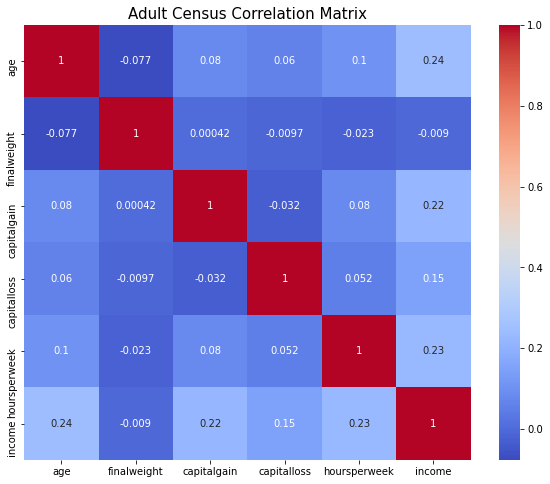

In [0]:
# Select only numeric columns
numeric_cols = [c for c,t in df.dtypes if t in ['double', 'int']]

# Create vector assembler to combine numeric columns into a single vector column
assembler = VectorAssembler(inputCols=numeric_cols, outputCol='features')
assembled_df = assembler.transform(df).select('features')

# Compute correlation matrix
correlation_matrix = Correlation.corr(assembled_df, 'features').head()

# Convert correlation matrix to a Pandas DataFrame for plotting
corr_matrix_pd = correlation_matrix[0].toArray()
corr_matrix = pd.DataFrame(corr_matrix_pd, columns=numeric_cols, index=numeric_cols)

# Plot correlation matrix
fig, ax = plt.subplots(figsize=(10,8))
sns.heatmap(data=corr_matrix, annot=True, cmap='coolwarm')
ax.set_title('Adult Census Correlation Matrix', fontsize=15);


/databricks/python/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



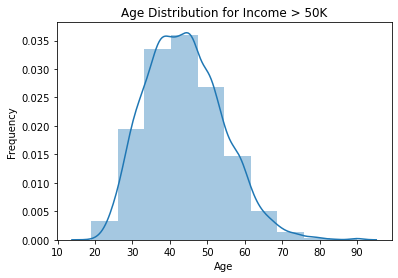

In [0]:
# filter the DataFrame to only include those with income equal to 1
df_filtered = df.filter(df.income == 1)

# convert the PySpark DataFrame to a Pandas DataFrame
pandas_df_age = df_filtered.select('age').toPandas()

# create a histogram of age using seaborn
sns.distplot(pandas_df_age['age'], bins=10)
plt.title('Age Distribution for Income > 50K')
plt.xlabel('Age')
plt.ylabel('Frequency')
plt.show()

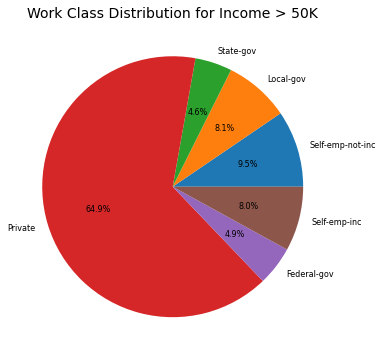

In [0]:
# group the filtered DataFrame by work class and count the number of instances
grouped_df_workclass = df_filtered.groupBy('workclass').count()

# convert the PySpark DataFrame to a Pandas DataFrame
pandas_df_workclass = grouped_df_workclass.toPandas()

# create a pie chart of work class using matplotlib
plt.figure(figsize=(6, 6))
plt.pie(pandas_df_workclass['count'], labels=pandas_df_workclass['workclass'], autopct='%1.1f%%', textprops={'fontsize': 8})

plt.title('Work Class Distribution for Income > 50K', fontsize=14)
plt.show()

In [0]:

# Convert the PySpark DataFrame to a Pandas DataFrame, and create a scatter plot using the "age", "hoursperweek", and "income" columns
fig = px.scatter(df.toPandas(), x="age", y="hoursperweek", color="income", hover_data=['education', 'occupation'])

# Update the layout of the scatter plot with a title and axis labels
fig.update_layout(title='Age vs. Hours per Week', xaxis_title='Age', yaxis_title='Hours per Week')

# Display the scatter plot
fig.show()


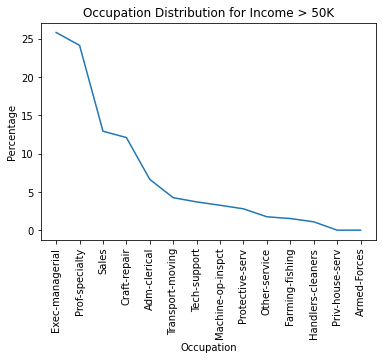

In [0]:
# group the filtered DataFrame by occupation and calculate the percentage of instances
grouped_df = df_filtered.groupBy('occupation').count()
grouped_df_occupation = grouped_df.withColumn('percentage', grouped_df['count'] / df_filtered.count() * 100)

# sort the grouped DataFrame by percentage in descending order
sorted_df = grouped_df_occupation.sort('percentage', ascending=False)

# convert the PySpark DataFrame to a Pandas DataFrame
pandas_df = sorted_df.toPandas()

# create a line graph of occupation using seaborn
sns.lineplot(data=pandas_df, x='occupation', y='percentage')
plt.title('Occupation Distribution for Income > 50K')
plt.xlabel('Occupation')
plt.ylabel('Percentage')
plt.xticks(rotation=90)
plt.show()


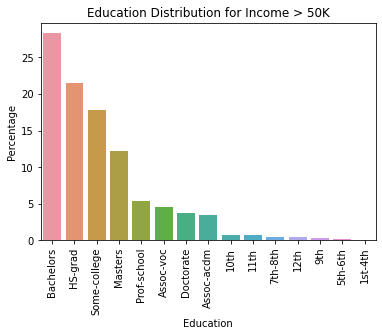

In [0]:
from pyspark.sql import functions as F

# group the filtered DataFrame by education and calculate the percentage of instances
grouped_df = df_filtered.groupBy('education').count()
grouped_df_education = grouped_df.withColumn('percentage', grouped_df['count'] / df_filtered.count() * 100)

# sort the DataFrame by percentage in descending order
grouped_df = grouped_df_education.sort(F.desc('percentage'))

# convert the PySpark DataFrame to a Pandas DataFrame
pandas_df = grouped_df.toPandas()

# create a bar graph of education using seaborn
sns.barplot(data=pandas_df, x='education', y='percentage')
plt.title('Education Distribution for Income > 50K')
plt.xlabel('Education')
plt.ylabel('Percentage')

# rotate the x-axis labels by 90 degrees
plt.xticks(rotation=90)

plt.show()

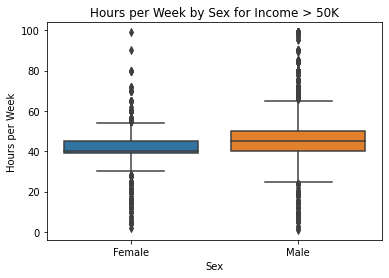

In [0]:
# create a boxplot using seaborn
sns.boxplot(x='sex', y='hoursperweek', data=df_filtered.toPandas())

# add labels and title
plt.title('Hours per Week by Sex for Income > 50K')
plt.xlabel('Sex')
plt.ylabel('Hours per Week')

plt.show()

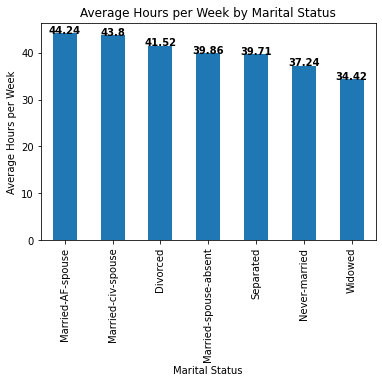

In [0]:
# Select marital status and hours per week columns
df_filtered_1 = df.select("maritalstatus", "hoursperweek")

# Group the data by marital status and calculate the average hours per week
grouped_df_ms_hpw = df_filtered_1.groupBy("maritalstatus").agg(avg("hoursperweek").alias("avghours"))

# Order by average hours per week in descending order
sorted_df = grouped_df_ms_hpw.orderBy("avghours", ascending=False)

# Convert PySpark DataFrame to Pandas DataFrame
pandas_df = sorted_df.toPandas()

# Plot a bar graph of the average hours per week by marital status using Pandas and Matplotlib
pandas_df.plot(kind="bar", x="maritalstatus", y="avghours", legend=None)
plt.xlabel("Marital Status")
plt.ylabel("Average Hours per Week")
plt.title("Average Hours per Week by Marital Status")
plt.xticks(rotation=90)

# Display the values on top of each bar
for index, row in pandas_df.iterrows():
    plt.text(index, row["avghours"], round(row["avghours"],2), ha='center', fontweight='bold')

plt.show()

In [0]:
#model building

trainDF, testDF = df.randomSplit([0.7, 0.3], seed=45)
print(trainDF.cache().count()) # Cache because accessing training data multiple times
print(testDF.count())

21119
9043


In [0]:
#converting categorical variables to numeric variables

from pyspark.ml.feature import StringIndexer, OneHotEncoder
 
categorical_columns = ["workclass", "education", "maritalstatus", "occupation", "relationship", "race", "sex"]
 
# The following two lines are estimators. They return functions that we will later apply to transform the dataset.
stringIndexer = StringIndexer(inputCols=categorical_columns, outputCols=[x + "Index" for x in categorical_columns]) 
encoder = OneHotEncoder(inputCols=stringIndexer.getOutputCols(), outputCols=[x + "OHE" for x in categorical_columns]) 
 
# The label column ("income") is also a string value - it has two possible values, "<=50K" and ">50K". 
# Convert it to a numeric value using StringIndexer.
labelToIndex = StringIndexer(inputCol="income", outputCol="label")

In [0]:
stringIndexerModel = stringIndexer.fit(trainDF)
display(stringIndexerModel.transform(trainDF))

age,workclass,finalweight,education,maritalstatus,occupation,relationship,race,sex,capitalgain,capitalloss,hoursperweek,nativecountry,income,workclassIndex,educationIndex,maritalstatusIndex,occupationIndex,relationshipIndex,raceIndex,sexIndex
17,Local-gov,32124,9th,Never-married,Other-service,Own-child,Black,Male,0,0,9,United-States,0,2.0,10.0,1.0,5.0,2.0,1.0,0.0
17,Local-gov,148194,11th,Never-married,Adm-clerical,Own-child,White,Female,0,0,12,United-States,0,2.0,5.0,1.0,3.0,2.0,0.0,1.0
17,Local-gov,170916,10th,Never-married,Protective-serv,Own-child,White,Female,0,1602,40,United-States,0,2.0,7.0,1.0,11.0,2.0,0.0,1.0
17,Local-gov,173497,11th,Never-married,Prof-specialty,Own-child,Black,Male,0,0,15,United-States,0,2.0,5.0,1.0,0.0,2.0,1.0,0.0
17,Local-gov,182070,11th,Never-married,Other-service,Own-child,White,Female,0,0,16,United-States,0,2.0,5.0,1.0,5.0,2.0,0.0,1.0
17,Local-gov,192387,9th,Never-married,Other-service,Own-child,White,Male,0,0,45,United-States,0,2.0,10.0,1.0,5.0,2.0,0.0,0.0
17,Local-gov,195262,11th,Never-married,Craft-repair,Own-child,White,Male,0,0,35,United-States,0,2.0,5.0,1.0,1.0,2.0,0.0,0.0
17,Local-gov,244856,11th,Never-married,Prof-specialty,Own-child,White,Female,0,0,40,United-States,0,2.0,5.0,1.0,0.0,2.0,0.0,1.0
17,Local-gov,246308,11th,Never-married,Prof-specialty,Own-child,White,Female,0,0,20,Puerto-Rico,0,2.0,5.0,1.0,0.0,2.0,0.0,1.0
17,Local-gov,308901,11th,Never-married,Adm-clerical,Own-child,White,Female,0,0,15,United-States,0,2.0,5.0,1.0,3.0,2.0,0.0,1.0


In [0]:
from pyspark.ml.feature import VectorAssembler
 
# This includes both the numeric columns and the one-hot encoded binary vector columns in our dataset.
numeric_columns = ["age", "capitalgain", "capitalloss", "hoursperweek"]
assemblerInputs = [c + "OHE" for c in categorical_columns] + numeric_columns
vecAssembler = VectorAssembler(inputCols=assemblerInputs, outputCol="features")

In [0]:
#defining the model
from pyspark.ml.classification import LogisticRegression
 
lr = LogisticRegression(featuresCol="features", labelCol="label", regParam=1.0)

In [0]:
from pyspark.ml import Pipeline
 
# Define the pipeline based on the stages created in previous steps.
pipeline = Pipeline(stages=[stringIndexer, encoder, labelToIndex, vecAssembler, lr])
 
# Define the pipeline model.
pipelineModel = pipeline.fit(trainDF)
 
# Apply the pipeline model to the test dataset.
predDF = pipelineModel.transform(testDF)



In [0]:
display(predDF.select("features", "label", "prediction", "probability"))

features,label,prediction,probability
"Map(vectorType -> sparse, length -> 54, indices -> List(5, 11, 22, 30, 41, 46, 50, 52, 53), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 17.0, 1602.0, 40.0))",0.0,0.0,"Map(vectorType -> dense, length -> 2, values -> List(0.8425142355800217, 0.1574857644199783))"
"Map(vectorType -> sparse, length -> 54, indices -> List(2, 13, 22, 32, 42, 45, 50, 53), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 17.0, 25.0))",0.0,0.0,"Map(vectorType -> dense, length -> 2, values -> List(0.8846384418149611, 0.1153615581850389))"
"Map(vectorType -> sparse, length -> 54, indices -> List(2, 11, 22, 38, 42, 45, 49, 50, 53), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 17.0, 30.0))",0.0,0.0,"Map(vectorType -> dense, length -> 2, values -> List(0.8457071032719271, 0.1542928967280729))"
"Map(vectorType -> sparse, length -> 54, indices -> List(2, 11, 22, 31, 42, 45, 49, 50, 53), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 17.0, 20.0))",0.0,0.0,"Map(vectorType -> dense, length -> 2, values -> List(0.8569291646493254, 0.14307083535067455))"
"Map(vectorType -> sparse, length -> 54, indices -> List(0, 17, 22, 35, 42, 45, 49, 50, 53), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 17.0, 15.0))",0.0,0.0,"Map(vectorType -> dense, length -> 2, values -> List(0.882743361222187, 0.117256638777813))"
"Map(vectorType -> sparse, length -> 54, indices -> List(0, 13, 22, 32, 42, 45, 50, 53), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 17.0, 30.0))",0.0,0.0,"Map(vectorType -> dense, length -> 2, values -> List(0.888916187312032, 0.11108381268796796))"
"Map(vectorType -> sparse, length -> 54, indices -> List(0, 13, 22, 32, 42, 45, 50, 53), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 17.0, 25.0))",0.0,0.0,"Map(vectorType -> dense, length -> 2, values -> List(0.8913488188759219, 0.10865118112407812))"
"Map(vectorType -> sparse, length -> 54, indices -> List(0, 13, 22, 36, 42, 45, 49, 50, 53), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 17.0, 40.0))",0.0,0.0,"Map(vectorType -> dense, length -> 2, values -> List(0.872771900117243, 0.12722809988275696))"
"Map(vectorType -> sparse, length -> 54, indices -> List(0, 14, 22, 31, 42, 45, 49, 50, 53), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 17.0, 8.0))",0.0,0.0,"Map(vectorType -> dense, length -> 2, values -> List(0.8758298160837256, 0.12417018391627443))"
"Map(vectorType -> sparse, length -> 54, indices -> List(0, 11, 22, 27, 42, 45, 50, 53), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 17.0, 20.0))",0.0,0.0,"Map(vectorType -> dense, length -> 2, values -> List(0.8632002577107727, 0.1367997422892273))"


In [0]:
display(pipelineModel.stages[-1], predDF.drop("prediction", "rawPrediction", "probability"), "ROC")

False Positive Rate,True Positive Rate,Threshold
0.0,0.0,0.5337020661045013
0.011904761904761904,0.0,0.5337020661045013
0.011904761904761904,0.03125,0.5298255210390584
0.011904761904761904,0.0625,0.5033737095217268
0.011904761904761904,0.09375,0.470521345756845
0.011904761904761904,0.125,0.45465039039757693
0.023809523809523808,0.125,0.4476003992804414
0.03571428571428571,0.125,0.4414268303976382
0.03571428571428571,0.15625,0.4353063327134532
0.03571428571428571,0.1875,0.4329295551906046


In [0]:
from pyspark.ml.evaluation import BinaryClassificationEvaluator, MulticlassClassificationEvaluator
 
bcEvaluator = BinaryClassificationEvaluator(metricName="areaUnderROC")
print(f"Area under ROC curve: {bcEvaluator.evaluate(predDF)}")
 
mcEvaluator = MulticlassClassificationEvaluator(metricName="accuracy")
print(f"Accuracy: {mcEvaluator.evaluate(predDF)}")


f1Evaluator = MulticlassClassificationEvaluator(metricName="f1")
print(f"F1 score: {f1Evaluator.evaluate(predDF)}")

Area under ROC curve: 0.8774482477096943
Accuracy: 0.7629105385380958


In [0]:
from pyspark.ml.tuning import ParamGridBuilder, CrossValidator
 
paramGrid = (ParamGridBuilder()
             .addGrid(lr.regParam, [0.01, 0.5, 2.0])
             .addGrid(lr.elasticNetParam, [0.0, 0.5, 1.0])
             .build())

In [0]:
# Create a 3-fold CrossValidator
cv = CrossValidator(estimator=pipeline, estimatorParamMaps=paramGrid, evaluator=bcEvaluator, numFolds=3, parallelism = 4)
 
# Run cross validations. This step takes a few minutes and returns the best model found from the cross validation.
cvModel = cv.fit(trainDF)

In [0]:
# Use the model identified by the cross-validation to make predictions on the test dataset
cvPredDF = cvModel.transform(testDF)
 
# Evaluate the model's performance based on area under the ROC curve and accuracy 
print(f"Area under ROC curve: {bcEvaluator.evaluate(cvPredDF)}")
print(f"Accuracy: {mcEvaluator.evaluate(cvPredDF)}")

f1Evaluator = MulticlassClassificationEvaluator(metricName="f1")
print(f"F1 score: {f1Evaluator.evaluate(cvPredDF)}")

In [0]:
from sklearn.metrics import confusion_matrix
y_pred=cvPredDF.select("prediction").collect()
y_orig=cvPredDF.select("label").collect()

cm = confusion_matrix(y_orig, y_pred)
print("Confusion Matrix:")
print(cm)

In [0]:
#randomforestclassifier
from pyspark.ml.classification import RandomForestClassifier
rforest = RandomForestClassifier(featuresCol="features", labelCol="label")

In [0]:
pipeline_rforest=Pipeline(stages=[stringIndexer, encoder, labelToIndex, vecAssembler,rforest])

In [0]:
pipelineModel_rforest=pipeline_rforest.fit(trainDF)
predDF_rforest=pipelineModel_rforest.transform(testDF)

In [0]:
display(predDF_rforest.select("features", "label", "prediction", "probability"))

In [0]:
from pyspark.ml.evaluation import BinaryClassificationEvaluator, MulticlassClassificationEvaluator
 
bcEvaluator = BinaryClassificationEvaluator(metricName="areaUnderROC")
print(f"Area under ROC curve: {bcEvaluator.evaluate(predDF_rforest)}")
 
mcEvaluator = MulticlassClassificationEvaluator(metricName="accuracy")
print(f"Accuracy: {mcEvaluator.evaluate(predDF_rforest)}")

f1Evaluator = MulticlassClassificationEvaluator(metricName="f1")
print(f"F1 score: {f1Evaluator.evaluate(predDF_rforest)}")

In [0]:
from sklearn.metrics import confusion_matrix
y_pred=predDF_rforest.select("prediction").collect()
y_orig=predDF_rforest.select("label").collect()

cm = confusion_matrix(y_orig, y_pred)
print("Confusion Matrix:")
print(cm)

In [0]:
#naive bayes
from pyspark.ml.classification import NaiveBayes
from pyspark.ml.evaluation import MulticlassClassificationEvaluator

In [0]:
nb = NaiveBayes(smoothing=1.0, modelType="multinomial")

In [0]:
#2.6 Importing and building the pipeline
#from pyspark.ml import Pipeline
pipeline_naivebayes = Pipeline(stages=[stringIndexer, encoder,labelToIndex, vecAssembler, nb])
pipelineModel_naivebayes = pipeline_naivebayes.fit(trainDF)
predDF_naivebayes = pipelineModel_naivebayes.transform(testDF)

In [0]:
from pyspark.ml.evaluation import BinaryClassificationEvaluator, MulticlassClassificationEvaluator
 
bcEvaluator = BinaryClassificationEvaluator(metricName="areaUnderROC")
print(f"Area under ROC curve: {bcEvaluator.evaluate(predDF_naivebayes)}")
 
mcEvaluator = MulticlassClassificationEvaluator(metricName="accuracy")
print(f"Accuracy: {mcEvaluator.evaluate(predDF_naivebayes)}")

f1Evaluator = MulticlassClassificationEvaluator(metricName="f1")
print(f"F1 score: {f1Evaluator.evaluate(predDF_naivebayes)}")



In [0]:
from sklearn.metrics import confusion_matrix
y_pred=predDF_naivebayes.select("prediction").collect()
y_orig=predDF_naivebayes.select("label").collect()

cm = confusion_matrix(y_orig, y_pred)
print("Confusion Matrix:")
print(cm)

In [0]:
predDF_naivebayes.show()

In [0]:
#DecisionTreeClassifier
from pyspark.ml.classification import DecisionTreeClassifier
dtc = DecisionTreeClassifier(featuresCol="features", labelCol="label")

In [0]:
pipeline_dtc = Pipeline(stages=[stringIndexer, encoder, labelToIndex, vecAssembler, dtc])


In [0]:
pipelineModel_dtc = pipeline_dtc.fit(trainDF)
predDF_dtc = pipelineModel_dtc.transform(testDF)

In [0]:
from pyspark.ml.evaluation import BinaryClassificationEvaluator, MulticlassClassificationEvaluator

bcEvaluator = BinaryClassificationEvaluator(metricName="areaUnderROC")
print(f"Area under ROC curve: {bcEvaluator.evaluate(predDF_dtc)}")
 
mcEvaluator = MulticlassClassificationEvaluator(metricName="accuracy")
print(f"Accuracy: {mcEvaluator.evaluate(predDF_dtc)}")

mcEvaluator = MulticlassClassificationEvaluator(metricName="f1")
print(f"F1 score: {mcEvaluator.evaluate(predDF_dtc)}")